<a href="https://colab.research.google.com/github/sanket-dse/Fact_vs_Opinion_Computational-Linguistics/blob/main/Comp_ling_Classification_models2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Uploading datasets with POS tags

In [ ]:
from google.colab import files
files.upload()

Saving X_test_tagged.csv to X_test_tagged.csv
Saving X_train_tagged.csv to X_train_tagged.csv
Saving y_test.csv to y_test.csv
Saving y_train.csv to y_train.csv


{'X_test_tagged.csv': b'article_content\n[\'_JJ disaster_NN claims_NNS less_JJR than_IN $_$ 10bn_CD insurers_NNS have_VBP sought_VBN to_TO calm_VB fears_NNS that_IN they_PRP face_VBP huge_JJ losses_NNS after_IN an_DT earthquake_NN and_CC giant_NN waves_NNS killed_VBN at_IN least_JJS 38_CD 000_CD people_NNS in_IN southern_JJ asia_NN ._. munich_JJ re_NN and_CC swiss_JJ re_NN the_DT world_NN s_NN two_CD biggest_JJS reinsurers_NNS have_VBP said_VBD exposure_NN will_MD be_VB less_JJR than_IN for_IN other_JJ disasters_NNS ._. rebuilding_NN costs_NNS are_VBP likely_JJ to_TO be_VB cheaper_JJR than_IN in_IN developed_JJ countries_NNS and_CC many_JJ of_IN those_DT affected_VBN will_MD not_RB have_VB insurance_NN analysts_NNS said_VBD ._. swiss_JJ re_NN has_VBZ said_VBD total_JJ claims_NNS are_VBP likely_JJ to_TO be_VB less_JJR than_IN $_$ 10bn_CD (\xc2\xa3_NNP 5_CD ._. 17bn_CD )._JJ swiss_JJ re_NN believes_VBZ that_IN the_DT cost_NN would_MD be_VB substantial_JJ but_CC that_IN it_PRP is_VBZ unli

In [ ]:
from google.colab import files
files.upload()

Saving test_dataset.csv to test_dataset.csv


{'test_dataset.csv': b'article_content,category\r\n"A key debate after the enactment of three farm-reform laws and the subsequent protests is around the issue of federally-fixed minimum support prices (MSPs), a system guaranteeing farmers assured prices for their produce through procurement. MSP is an obligatory, not a statutory exercise. Farmers have demanded a legislation to prohibit sale of any farm produce below these minimum prices. If the government agrees to this, it is likely they will end their protests against the three new farm reforms.But a law making MSPs the legal floor price defies economic logic. The government sets MSPs for 23 crops, but it is effective only in case of rice and wheat because it buys only these two commodities in sufficiently large quantities. MSPs are an assurance that the government will intervene if market rates fall below that threshold, thereby helping avoid distress sale. This policy was salutary when India faced acute food shortages. Farm policie

In [ ]:
import pandas as pd
X_train_tagged=pd.read_csv('X_train_tagged.csv')
X_test_tagged=pd.read_csv('X_test_tagged.csv')
y_train=pd.read_csv('y_train.csv')
y_test=pd.read_csv('y_test.csv')
fintest=pd.read_csv("test_dataset.csv")
X_fintest=fintest.article_content
y_fintest=fintest.category


0    A key debate after the enactment of three farm...
1    As the contribution of renewable energy (RE) i...
2    After years of flirting with politics and drop...
3    Are these really farmers who are blocking the ...
4    The Reserve Bank of India (RBI), the sentinel ...
5    The South Korean industrial giant is working w...
6    Seagate today launched a limited edition game ...
7    The eight-month Covid lockdown restrictions ha...
8    Four men have been arrested and valuables wort...
9    The Centre for Science and Environment (CSE) o...
Name: article_content, dtype: object

## POS Tagging final testing datasets

In [ ]:
import nltk
nltk.download('averaged_perceptron_tagger')
# POS tagging final test dataset

X_fintest_pos=[]
for i in range(0,10):
  test_temp=''
  wpt = nltk.WordPunctTokenizer()
  text2= wpt.tokenize(str(X_fintest[i]))
  text_tagged2 = nltk.pos_tag(text2)
  new_text2=[]
  for word in text_tagged2:
     new_text2.append(word[0]+"_"+word[1])

  test_temp = ' '.join(new_text2)
  X_fintest_pos.append(test_temp)




[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


10

In [ ]:
import numpy as np
X_train_pos=np.array(X_train_tagged).reshape(3788,)
X_test_pos=np.array(X_test_tagged).reshape(420,)
y_tr=np.array(y_train).reshape(3788,)
y_ts=np.array(y_test).reshape(420,)

# Classification models with POS tags
## Naive Bayes classifier

Using unigrams

In [ ]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import nltk
nltk.download('stopwords')


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer #<-- these weights different words in the document based on many features like from,crime etc as per the appearence
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import make_pipeline #<--these is used for information transfer

## Development set

#creating a model based on multinomial naive bayes
model1=make_pipeline(TfidfVectorizer(lowercase=True,ngram_range=(1,1)),MultinomialNB())#<--the information we are getting in TfidfVectorizer is pumped in MultinomialNM() using make_pipeline function

#training the model with the train data
model1.fit(X_train_pos,y_tr)

#creating the label for test data
labels1=model1.predict(X_test_pos)
#print(labels)

## Final test set

labels2=model1.predict(X_fintest_pos)



### Evaluation metrics

***** On development set******
Accuracy score :  0.9785714285714285
f1 score :  0.9785615844010005


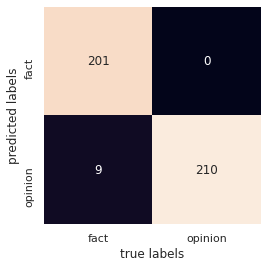

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On development set******")
mat1=confusion_matrix(y_ts,labels1)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_ts,labels1))
print("f1 score : ",f1_score(y_ts,labels1,average='weighted'))



***** On final test set******
Accuracy score :  0.6
f1 score :  0.523809523809524


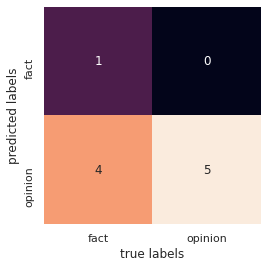

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On final test set******")
mat1=confusion_matrix(y_fintest,labels2)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_fintest,labels2))
print("f1 score : ",f1_score(y_fintest,labels2,average='weighted'))



## Naive Bayes Classifier

Using bigrams


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer #<-- these weights different words in the document based on many features like from,crime etc as per the appearence
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import make_pipeline #<--these is used for information transfer

## On development set

#creating a model based on multinomial naive bayes
model1=make_pipeline(TfidfVectorizer(lowercase=True,ngram_range=(2,2)),MultinomialNB())#<--the information we are getting in TfidfVectorizer is pumped in MultinomialNM() using make_pipeline function

#training the model with the train data
model1.fit(X_train_pos,y_tr)

#creating the label for test data
labels1=model1.predict(X_test_pos)
#print(labels)

## On final test set

labels2=model1.predict(X_fintest_pos)


### Evaluation metrics

Accuracy score :  0.9619047619047619
f1 score :  0.9618493959487694


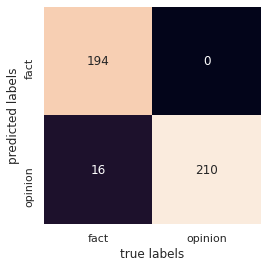

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

mat1=confusion_matrix(y_ts,labels1)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_ts,labels1))
print("f1 score : ",f1_score(y_ts,labels1,average='weighted'))



***** On final test set******
Accuracy score :  0.6
f1 score :  0.523809523809524


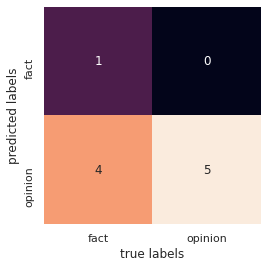

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On final test set******")
mat1=confusion_matrix(y_fintest,labels2)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_fintest,labels2))
print("f1 score : ",f1_score(y_fintest,labels2,average='weighted'))



## Naive Bayes Classifier

Using Trigrams

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer #<-- these weights different words in the document based on many features like from,crime etc as per the appearence
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import make_pipeline #<--these is used for information transfer



#creating a model based on multinomial naive bayes
model1=make_pipeline(TfidfVectorizer(lowercase=True,ngram_range=(3,3)),MultinomialNB())#<--the information we are getting in TfidfVectorizer is pumped in MultinomialNM() using make_pipeline function

#training the model with the train data
model1.fit(X_train_pos,y_tr)

#creating the label for test data
labels1=model1.predict(X_test_pos)
#print(labels)

## On final test set

labels2=model1.predict(X_fintest_pos)


### Evaluation metrics

Accuracy score :  0.9904761904761905
f1 score :  0.9904753265602322


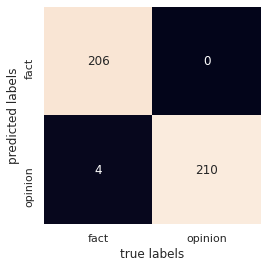

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

mat1=confusion_matrix(y_ts,labels1)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_ts,labels1))
print("f1 score : ",f1_score(y_ts,labels1,average='weighted'))


***** On final test set******
Accuracy score :  0.9
f1 score :  0.898989898989899


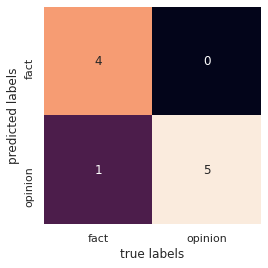

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On final test set******")
mat1=confusion_matrix(y_fintest,labels2)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_fintest,labels2))
print("f1 score : ",f1_score(y_fintest,labels2,average='weighted'))



## KNN classifier

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer #<-- these weights different words in the document based on many features like from,crime etc as per the appearence
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import make_pipeline #<--these is used for information transfer


#creating a model based on KNN
model1=make_pipeline(TfidfVectorizer(),KNeighborsClassifier(n_neighbors=2))#<--the information we are getting in TfidfVectorizer is pumped in MultinomialNM() using make_pipeline function
#print(model)

#training the model with the train data
model1.fit(X_train_pos,y_tr)

#creating the label for test data
labels1=model1.predict(X_test_pos)
#print(labels)

## On final test set

labels2=model1.predict(X_fintest_pos)

### Evaluation metrics

Accuracy score :  0.9785714285714285
f1 score :  0.9785654745365775


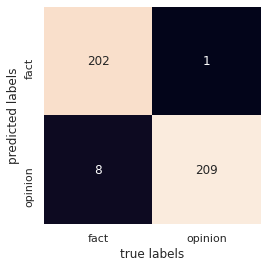

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

mat1=confusion_matrix(y_ts,labels1)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_ts,labels1))
print("f1 score : ",f1_score(y_ts,labels1,average='weighted'))

***** On final test set******
Accuracy score :  0.8
f1 score :  0.7916666666666666


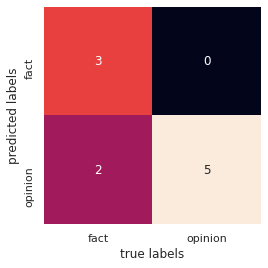

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On final test set******")
mat1=confusion_matrix(y_fintest,labels2)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_fintest,labels2))
print("f1 score : ",f1_score(y_fintest,labels2,average='weighted'))



## Random Forest

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer #<-- these weights different words in the document based on many features like from,crime etc as per the appearence
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline #<--these is used for information transfer


#creating a model based on KNN
model1=make_pipeline(TfidfVectorizer(),RandomForestClassifier(n_estimators=200,max_depth=2,random_state=0))#<--the information we are getting in TfidfVectorizer is pumped in MultinomialNM() using make_pipeline function
#print(model)

#training the model with the train data
model1.fit(X_train_pos,y_tr)

#creating the label for test data
labels1=model1.predict(X_test_pos)
#print(labels)

## On final testing dataset

labels2=model1.predict(X_fintest_pos)

### Evaluation Metrics

Accuracy score :  0.9714285714285714
f1 score :  0.9714259796806965


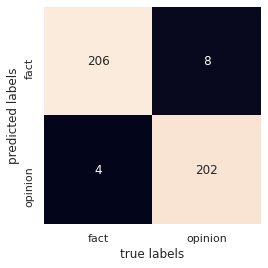

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

mat1=confusion_matrix(y_ts,labels1)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_ts,labels1))
print("f1 score : ",f1_score(y_ts,labels1,average='weighted'))

***** On final test set******
Accuracy score :  0.8
f1 score :  0.7916666666666666


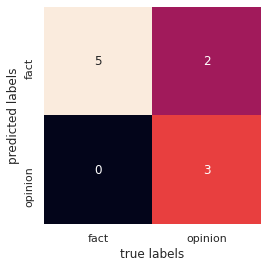

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On final test set******")
mat1=confusion_matrix(y_fintest,labels2)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_fintest,labels2))
print("f1 score : ",f1_score(y_fintest,labels2,average='weighted'))



## Support Vector Classifier(SVC)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer #<-- these weights different words in the document based on many features like from,crime etc as per the appearence
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline #<--these is used for information transfer
## Without removing stop words

#creating a model based on KNN
model1=make_pipeline(TfidfVectorizer(),SVC(gamma='scale',C=1.0,kernel='rbf'))#<--the information we are getting in TfidfVectorizer is pumped in MultinomialNM() using make_pipeline function
#print(model)

#training the model with the train data
model1.fit(X_train_pos,y_tr)

#creating the label for test data
labels1=model1.predict(X_test_pos)
#print(labels)

## On final testing dataset

labels2=model1.predict(X_fintest_pos)

### Evaluation metrics

Accuracy score :  1.0
f1 score :  1.0


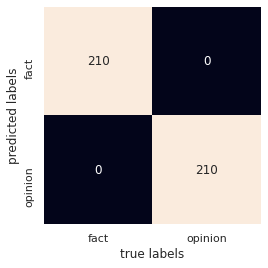

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

mat1=confusion_matrix(y_ts,labels1)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_ts,labels1))
print("f1 score : ",f1_score(y_ts,labels1,average='weighted'))

***** On final test set******
Accuracy score :  0.6
f1 score :  0.523809523809524


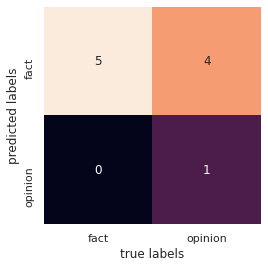

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score

print("***** On final test set******")
mat1=confusion_matrix(y_fintest,labels2)
sns.heatmap(mat1.T,square=True,annot=True,fmt='d',cbar=False,xticklabels=['fact','opinion'],yticklabels=['fact','opinion'])
#plotting heatmap of confusion matrix
plt.xlabel("true labels")
plt.ylabel("predicted labels")
print("Accuracy score : ",accuracy_score(y_fintest,labels2))
print("f1 score : ",f1_score(y_fintest,labels2,average='weighted'))

